# リッジラインプロット

## 概要

**リッジラインプロット（Ridgeline Plot）**とは，量的変数に対して，分布を滑らかな**曲線**で表現したグラフです．
[密度プロット](https://kakeami.github.io/viz-madb/charts4dists/density.html)（あるいは[バイオリンプロット](https://kakeami.github.io/viz-madb/charts4dists/violin.html)を90度回転したもの）を縦に並べ，文字通り山脈の稜線のような見た目をしています．
特に時系列的に変化する分布の推移を表現する際に強力です．

![](../figs/charts/ridgeline.png)

例えば上図は，マンガ作品「はじめの一歩」の100話ごとの掲載一部の分布の推移を表現したリッジラインプロットです．
500話付近から掲載位置が安定し始めていることがわかります．

## Plotlyによる作図方法

Plotlyでは直接リッジラインプロットを描画する関数がないため，バイオリンプロットを応用して作図します．

```python
import plotly.express as px
fig = px.violin(
    df, x='col_x', y='col_y', orientation='h',
    points=False)
fig.update_traces(side='positive')
```

基本的には[バイオリンプロットの作図方法](https://kakeami.github.io/viz-madb/charts4dists/violin.html#plotly)を踏襲しますが，以下が異なります：

- `x`と`y`の関係が逆：縦横反転するため，分布を見たい列を`x`で指定することにご注意ください．
- `orientation='h'`：これで縦横反転します．
- `side='positive'`：これで縦軸の上側のみ描画します．

## MADB Labを用いた作図例

### 下準備

In [1]:
import pandas as pd
import plotly.express as px

import warnings
warnings.filterwarnings('ignore')

In [2]:
# 前処理の結果，以下に分析対象ファイルが格納されていることを想定
PATH_DATA = '../../data/preprocess/out/episodes.csv'
# Jupyter Book用のPlotlyのrenderer
RENDERER = 'plotly_mimetype+notebook'

In [3]:
# 平均掲載位置を算出する際の最小連載数
MIN_WEEKS = 5

In [4]:
def show_fig(fig):
    """Jupyter Bookでも表示可能なようRendererを指定"""
    fig.update_layout(margin=dict(t=50, l=25, r=25, b=25))
    fig.show(renderer=RENDERER)

In [5]:
def add_years_to_df(df, unit_years=10):
    """unit_years単位で区切ったyears列を追加"""
    df_new = df.copy()
    df_new['years'] = \
        pd.to_datetime(df['datePublished']).dt.year \
        // unit_years * unit_years
    df_new['years'] = df_new['years'].astype(str)
    return df_new

In [6]:
df = pd.read_csv(PATH_DATA)

### 長期連載作品の話数毎の掲載位置の分布

In [9]:
df_tmp = \
    df.groupby('cname')['pageStartPosition']\
    .agg(['count', 'mean']).reset_index()
df_tmp = \
    df_tmp.sort_values('count', ascending=False, ignore_index=True)\
    .head(10)
cname2position = df_tmp.groupby('cname')['mean'].first().to_dict()

In [10]:
df_plot = df[df['cname'].isin(list(cname2position.keys()))]\
    .reset_index(drop=True)
df_plot['position'] = df_plot['cname'].apply(
    lambda x: cname2position[x])
df_plot = df_plot.sort_values('position', ignore_index=True)

In [14]:
# 話数の区切り
UNIT_EP = 100

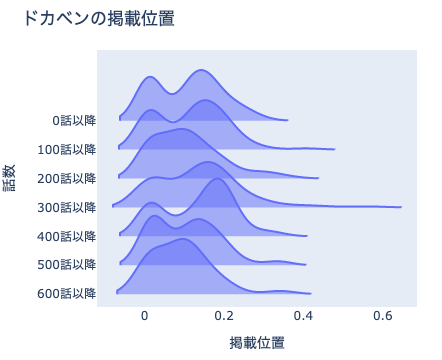

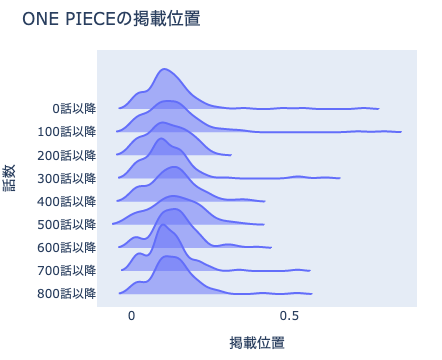

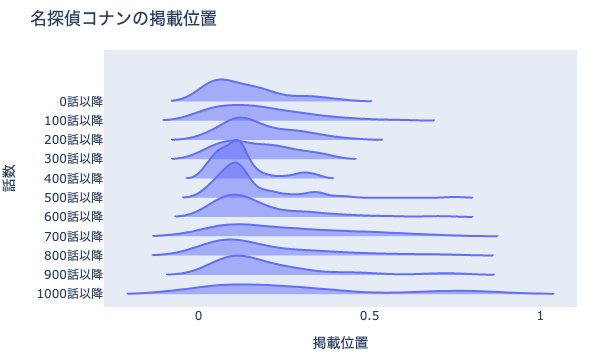

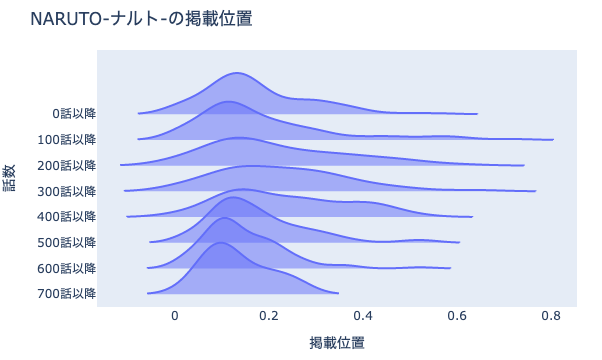

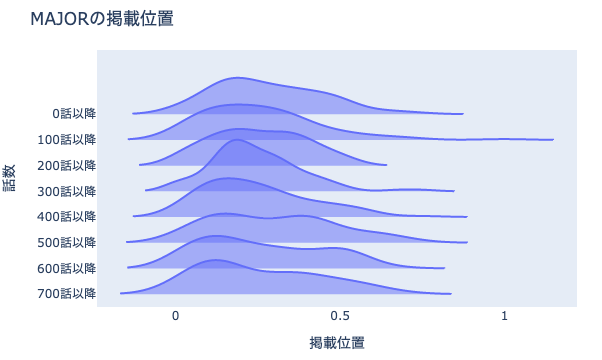

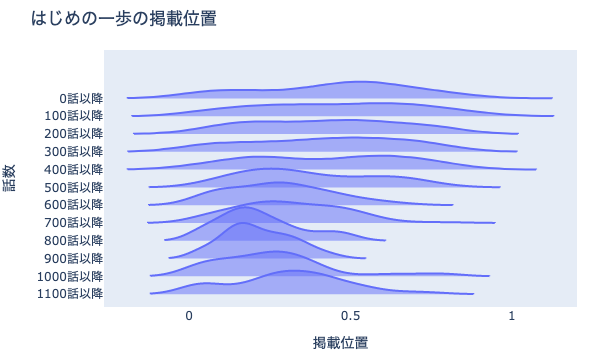

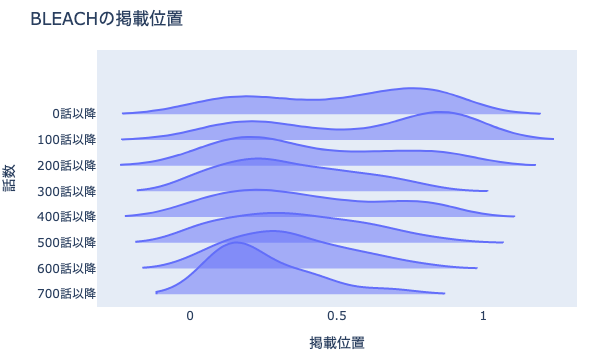

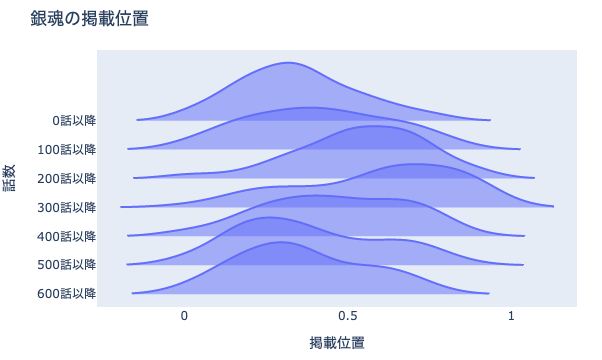

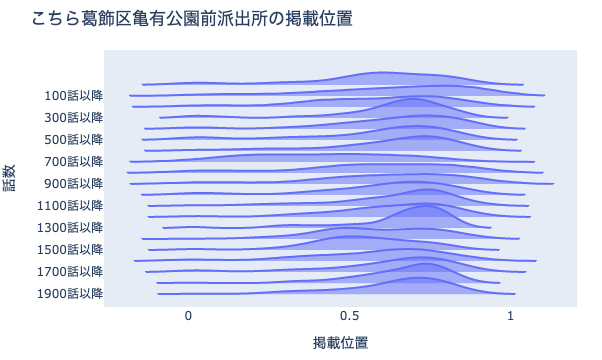

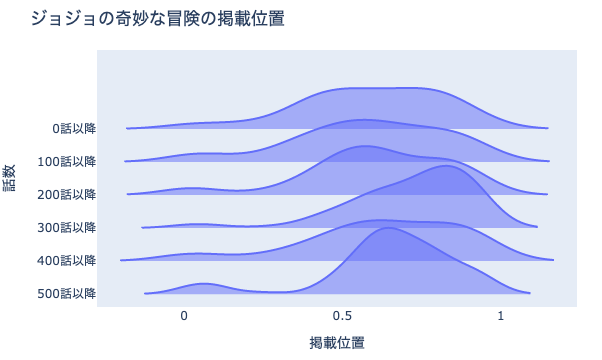

In [16]:
cnames = df_plot['cname'].unique()
for cname in cnames:
    df_c = df_plot[df_plot['cname']==cname].reset_index(drop=True)
    df_c['eprange'] = (df_c.index + 1) // UNIT_EP * UNIT_EP
    df_c = df_c.sort_values('eprange', ascending=False, ignore_index=False)
    df_c['eprange'] = df_c['eprange'].apply(
        lambda x: f'{x}話以降')
    fig = px.violin(
        df_c, y='eprange', x='pageStartPosition',
        title=f'{cname}の掲載位置', orientation='h',
        points=False)
    fig.update_traces(
        side='positive', scalemode='count', width=4)
    fig.update_layout(xaxis_showgrid=False, xaxis_zeroline=False)
    fig.update_xaxes(title='掲載位置')
    fig.update_yaxes(title='話数')
    show_fig(fig)